<a href="https://colab.research.google.com/github/mattignal/mask-rcnn-fine-tune-pisa/blob/main/fine_tune_pisa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Fine-Tuning Custom Dataset with Mask-RCNN via Detectron2

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

In this notebook, we will:

* Import and structure the custom dataset
* Fine-tune the Mask-RCNN model pre-trained on the COCO segmentation dataset using the train and validation sets in our custom data
* Run inference using the model on our testing set

Our custom dataset involves images of the Leaning Tower of Pisa. Can we use instance segmentation to find it?

<img src="https://www.mercurynews.com/wp-content/uploads/2018/06/16_ITALY_PISA_TOWE.jpg" width="500">


# Install detectron2

In [1]:
# install dependencies: 
!pip install pyyaml==5.1
import torch, torchvision
assert torch.__version__.startswith("1.8")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html


They recommend restarting the colab runtime after installation. The following cell can accomplish this.


In [ ]:
# exit(0)  

In [11]:
# Imports

# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Run a pre-trained detectron2 model

We first download an image from the COCO dataset:

In [2]:
# cfg = get_cfg()
# # add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
# cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
# cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# # Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
# predictor = DefaultPredictor(cfg)

# Train on Leaning Tower of Pisa dataset

Our custom dataset will be fine-tuned on the pre-trained COCO model.

By training on the [The Leading Tower of Pisa segmentation dataset](https://github.com/matterport/Mask_RCNN/tree/master/samples/balloon), we will be able to quickly build a model to recognize and segment the tower, hereafter referred to as Pisa.

## Prepare the dataset

The dataset is in already in COCO format (see README.md) and is ready to be registered as a detectron datatset.

However, Detectron's built-in visualization library requires a different format so we'll need to write a function to prepare it for visualization.

In [4]:
# from google.colab import drive
# drive.mount('/content/drive')

import zipfile
with zipfile.ZipFile("drive/MyDrive/Pisa.zip","r") as zip_ref:
    zip_ref.extractall("Pisa")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [73]:
!wget https://github.com/mattignal/mask-rcnn-fine-tune-pisa/blob/main/Pisa.zip Pisa.zip
!unzip Piza.zip > Pisa/

--2021-04-11 17:53:43--  https://github.com/mattignal/mask-rcnn-fine-tune-pisa/blob/main/Pisa.zip
Resolving github.com (github.com)... 192.30.255.113
Connecting to github.com (github.com)|192.30.255.113|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/html]
Saving to: ‘Pisa.zip.1’

Pisa.zip.1              [ <=>                ]  99.25K  --.-KB/s    in 0.02s   

2021-04-11 17:53:44 (4.57 MB/s) - ‘Pisa.zip.1’ saved [101631]

--2021-04-11 17:53:44--  http://pisa.zip/
Resolving pisa.zip (pisa.zip)... failed: Name or service not known.
wget: unable to resolve host address ‘pisa.zip’
FINISHED --2021-04-11 17:53:44--
Total wall clock time: 0.4s
Downloaded: 1 files, 99K in 0.02s (4.57 MB/s)
/bin/bash: Pisa/: Is a directory


In [3]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("Pisa_train", {}, "Pisa/train.json", "Pisa/")
register_coco_instances("Pisa_val", {}, "Pisa/validation.json", "Pisa/")
register_coco_instances("Pisa_test", {}, "Pisa/test.json", "Pisa/")

In [8]:
from detectron2.structures import BoxMode

def create_viz_dicts(json_file, img_dir):
  """create data dictionary to prepare for viz"""
  
  # load json file
  with open(json_file) as f:
      json_file = json.load(f)
      imgs = json_file['images']
      imgs_anns = json_file['annotations']

  # create dictionary
  dataset_dicts = []
  for idx, v in enumerate(imgs):
      record = {}
      filename = os.path.join(img_dir, v["file_name"])
      height, width = cv2.imread(filename).shape[:2]
      record["file_name"] = filename
      record["image_id"] = idx
      record["height"] = height
      record["width"] = width
      
      # get annotations
      annotations_list = []
      annotations = json_file['annotations'][idx]

      # match image id to annotations image id
      while v['id'] != annotations['image_id']:
        idx += 1
        annotations = json_file['annotations'][idx]
      
      annotations_list.append(annotations) # add annotation

      # could be multiple annotations that match, continue looping
      while v['id'] == annotations['image_id']:
        idx += 1
        try:
          annotations = json_file['annotations'][idx]
        except IndexError:
          break
        if v['id'] == annotations['image_id']:
          annotations_list.append(annotations)

      # create objects containing all information
      objs = []
      for anno in annotations_list:
          segmentation = [x + 0.5 for sublist in anno['segmentation'] for x in sublist]
          obj = {
                  "bbox": anno['bbox'],
                  "bbox_mode": BoxMode.XYWH_ABS,
                  "segmentation": [segmentation],
                  "category_id": 0,
              }
          objs.append(obj)
      record["annotations"] = objs

      # append record to data dict
      dataset_dicts.append(record)

  return dataset_dicts

# set metadata with class
MetadataCatalog.get("Pisa_train").set(thing_classes=["Pisa"])
MetadataCatalog.get("Pisa_val").set(thing_classes=["Pisa"])
MetadataCatalog.get("Pisa_test").set(thing_classes=["Pisa"])
pisa_metadata = MetadataCatalog.get("Pisa_train")

Create visuals from train set, showing pre-labeled segments.

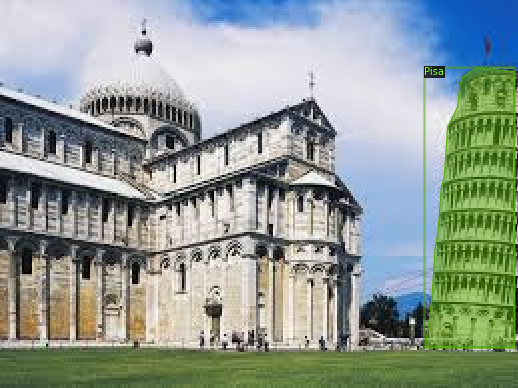

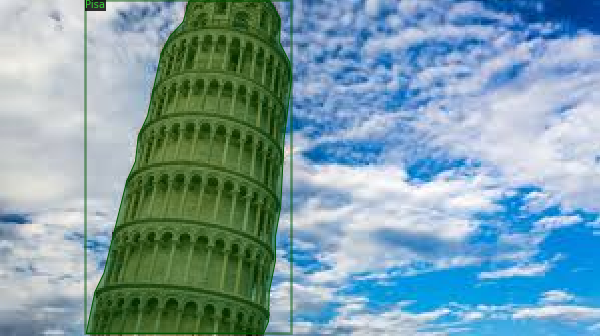

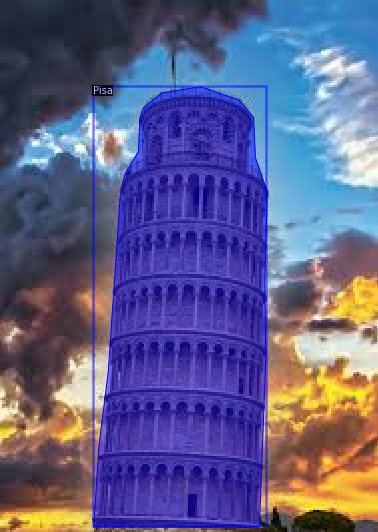

In [9]:
dataset_dicts = create_viz_dicts("Pisa/train.json", "Pisa/") # prepare data for viz
for d in random.sample(dataset_dicts, 3): # sample 3 at random
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=pisa_metadata, scale=2)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

## Training

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the Pisa dataset. 

It should only take a few minutes.


In [10]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("Pisa_train",)
cfg.DATASETS.TEST = ("Pisa_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  
cfg.SOLVER.MAX_ITER = 500     
cfg.SOLVER.STEPS = []        
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[04/11 15:59:58 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in

[04/11 16:00:00 d2.engine.train_loop]: Starting training from iteration 0
[04/11 16:00:09 d2.utils.events]:  eta: 0:03:20  iter: 19  total_loss: 1.629  loss_cls: 0.7376  loss_box_reg: 0.1456  loss_mask: 0.6949  loss_rpn_cls: 0.0436  loss_rpn_loc: 0.007532  time: 0.4323  data_time: 0.0172  lr: 4.9953e-06  max_mem: 2703M
[04/11 16:00:18 d2.utils.events]:  eta: 0:03:17  iter: 39  total_loss: 1.535  loss_cls: 0.6496  loss_box_reg: 0.1859  loss_mask: 0.6737  loss_rpn_cls: 0.02476  loss_rpn_loc: 0.006388  time: 0.4333  data_time: 0.0102  lr: 9.9902e-06  max_mem: 2703M
[04/11 16:00:26 d2.utils.events]:  eta: 0:03:10  iter: 59  total_loss: 1.39  loss_cls: 0.5248  loss_box_reg: 0.2114  loss_mask: 0.6302  loss_rpn_cls: 0.03073  loss_rpn_loc: 0.00688  time: 0.4353  data_time: 0.0087  lr: 1.4985e-05  max_mem: 2759M
[04/11 16:00:35 d2.utils.events]:  eta: 0:03:04  iter: 79  total_loss: 1.273  loss_cls: 0.4031  loss_box_reg: 0.2355  loss_mask: 0.5822  loss_rpn_cls: 0.0212  loss_rpn_loc: 0.006394  ti

In [12]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 455), started 1:31:59 ago. (Use '!kill 455' to kill it.)

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the Pisa test dataset. First, let's create a predictor using the model we just trained:



In [13]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

Then, we select several samples to visualize the prediction results.

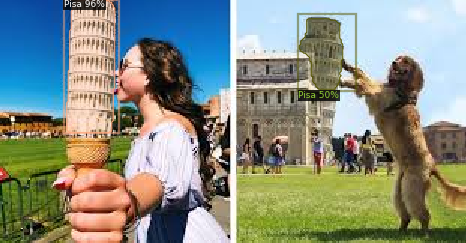

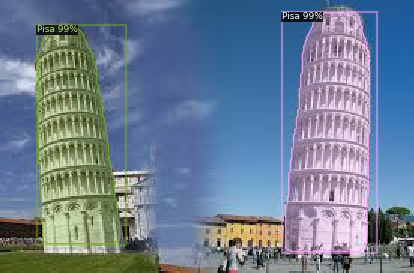

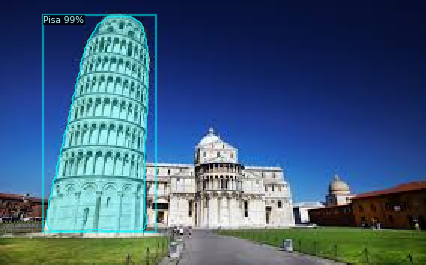

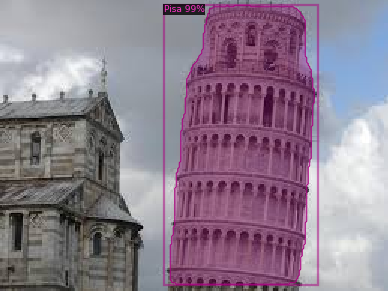

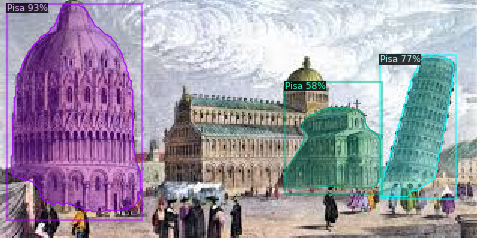

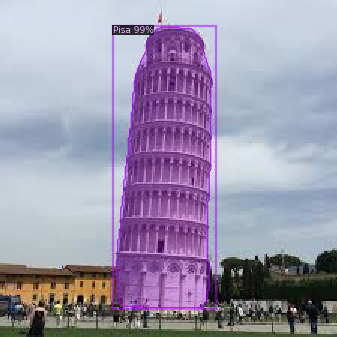

In [69]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = create_viz_dicts("Pisa/test.json", "Pisa/")

for d in dataset_dicts[:10]:  
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  
    v = Visualizer(im[:, :, ::-1],
                   metadata=MetadataCatalog.get("Pisa_train"),
                   scale=1.5, 
                   instance_mode=ColorMode.IMAGE_BW)   # not working?
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

As we can see, it struggles with the more challenging ones (e.g.the illustration) but does quite well on the most images after just a few minutes of training!

We can also evaluate its performance using the [AP metric](https://cocodataset.org/#detection-eval) (Average Precision) implemented in COCO API.

<img src="https://miro.medium.com/max/1400/1*_IkyrFHlqt_xCovk7l0rQQ.png" width="500">

After just a few minutes of training on a small dataset we are already north of 80%!

In [16]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("Pisa_test", ("bbox", "segm"), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "Pisa_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[04/11 16:52:21 d2.data.datasets.coco]: Loaded 6 images in COCO format from Pisa/test.json
[04/11 16:52:21 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    Pisa    | 8            |
|            |              |
[04/11 16:52:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[04/11 16:52:21 d2.data.common]: Serializing 6 elements to byte tensors and concatenating them all ...
[04/11 16:52:21 d2.data.common]: Serialized dataset takes 0.00 MiB
[04/11 16:52:21 d2.evaluation.evaluator]: Start inference on 6 images
[04/11 16:52:22 d2.evaluation.evaluator]: Total inference time: 0:00:00.121586 (0.121586 s / img per device, on 1 devices)
[04/11 16:52:22 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.079439 s / img per device, on 1 devices)
[04/11 16:52:22 d2.evaluation.coco_e

## Specific Examples

Play around with visualizations of specific examples

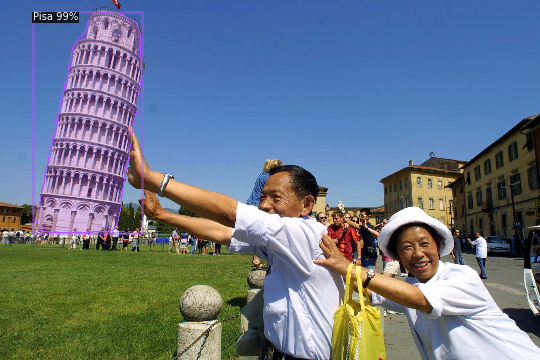

In [60]:
from skimage import io
from skimage.transform import rescale
import requests

url = r'https://www.mercurynews.com/wp-content/uploads/2018/06/16_ITALY_PISA_TOWE.jpg'
resp = requests.get(url, stream=True).raw
image = np.asarray(bytearray(resp.read()), dtype="uint8")
image = cv2.imdecode(image, cv2.IMREAD_COLOR)
im = cv2.resize(image, (0,0), fx=0.25, fy=0.25) 

outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
               metadata=MetadataCatalog.get("Pisa_train"),
               scale=1, 
               instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [67]:
from skimage import color
from skimage import draw

def create_splash(image, mask, gray_object=False):
    """
    WIP - Only seems to work on part of the image. 
    Apply color splash effect.
    """

    # grayscale image
    gray = color.gray2rgb(color.rgb2gray(image)) * 255

    # create list of pixels where there is the mask
    xs, ys = [], []
    count = 0
    for m in mask:
      for idx_y, y in enumerate(m):
          for idx_x, x in enumerate(y):
              if x.item() == True:
                xs.append(idx_x+1)
                ys.append(idx_y+1)

    # draw polygon for mask
    rr, cc = draw.polygon(ys,xs)

    # instantiate zeros
    mask2 = np.zeros([im.shape[0], im.shape[1], len(mask)], dtype=np.uint8)

    # fill in zeros where polygon should be
    for i in range(len(mask)):
      mask2[rr, cc, i] = 1

    # flatten into one mask if multiple
    mask2 = (np.sum(mask2, -1, keepdims=True) >= 1)

    if mask2.shape[0] > 0:
      if gray_object is True:
        splash = np.where(mask2, gray, image)
      else:
        splash = np.where(mask2, image, gray)
    else:
        splash = gray

    return splash

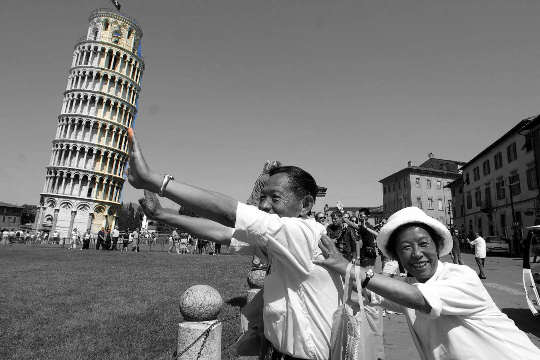

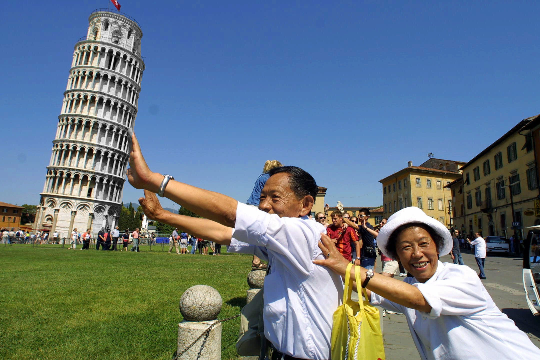

In [68]:
mask = outputs['instances'].get("pred_masks")
splash = create_splash(im, mask)
cv2_imshow(splash)
splash = create_splash(im, mask, gray_object=True)
cv2_imshow(splash)